<a href="https://colab.research.google.com/github/mithun-GA/projects/blob/main/av.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/ultralytics/yolov5
!pip install -qr yolov5/requirements.txt
%cd yolov5

import torch
from IPython.display import Image, clear_output
#from utils.google_utils import gdrive_download
!pip install google_utils

clear_output()

In [2]:
%cd /content
!curl -L "https://universe.roboflow.com/ds/F57yeg5NvU?key=LtcpGgKvPq" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

Streaming output truncated to the last 5000 lines.
 extracting: test/labels/014467_png_jpg.rf.f7053707c8506ea4a7ae3771b3cec4ee.txt  
 extracting: test/labels/014478_png_jpg.rf.3406bb3ac2f67d34d979490fd2765b7f.txt  
 extracting: test/labels/014570_png_jpg.rf.1e6f29b4d9e05ddf516783d4d2ee0e36.txt  
 extracting: test/labels/014581_png_jpg.rf.fad578a55c15d0068d67a87a616c96a3.txt  
 extracting: test/labels/014585_png_jpg.rf.939c59f432765797b65c5ada9505d68f.txt  
 extracting: test/labels/014585_png_jpg.rf.aa3ee38af89a4a17daccd63b2fc71a92.txt  
 extracting: test/labels/014632_png_jpg.rf.57d6aa5f4ba9390e640950b5a7c22033.txt  
 extracting: test/labels/014648_png_jpg.rf.c49475ef55c202352058d9d3e8e63052.txt  
 extracting: test/labels/014669_png_jpg.rf.9390d87a6b5d4562bcaf928306e038f8.txt  
 extracting: test/labels/014681_png_jpg.rf.885de6ef9d80c7d68fa168362ab0d8f6.txt  
 extracting: test/labels/016793_png_jpg.rf.3039275e4f2dd432a7d47f41b79b93d5.txt  
 extracting: test/labels/016799_png_jpg.rf.d442

In [3]:
#extracting information from the roboflow file
%cat data.yaml

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 10
names: ['bike', 'motobike', 'person', 'traffic_light_green', 'traffic_light_orange', 'traffic_light_red', 'traffic_sign_30', 'traffic_sign_60', 'traffic_sign_90', 'vehicle']

roboflow:
  workspace: selfdrivingcar-dcaqb
  project: road_objects-4laze
  version: 1
  license: CC BY 4.0
  url: https://universe.roboflow.com/selfdrivingcar-dcaqb/road_objects-4laze/dataset/1

In [4]:
# define number of classes based on data.yaml
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [5]:
%cat /content/yolov5/models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, AGPL-3.0 license

# Parameters
nc: 80 # number of classes
depth_multiple: 0.33 # model depth multiple
width_multiple: 0.50 # layer channel multiple
anchors:
  - [10, 13, 16, 30, 33, 23] # P3/8
  - [30, 61, 62, 45, 59, 119] # P4/16
  - [116, 90, 156, 198, 373, 326] # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [
    [-1, 1, Conv, [64, 6, 2, 2]], # 0-P1/2
    [-1, 1, Conv, [128, 3, 2]], # 1-P2/4
    [-1, 3, C3, [128]],
    [-1, 1, Conv, [256, 3, 2]], # 3-P3/8
    [-1, 6, C3, [256]],
    [-1, 1, Conv, [512, 3, 2]], # 5-P4/16
    [-1, 9, C3, [512]],
    [-1, 1, Conv, [1024, 3, 2]], # 7-P5/32
    [-1, 3, C3, [1024]],
    [-1, 1, SPPF, [1024, 5]], # 9
  ]

# YOLOv5 v6.0 head
head: [
    [-1, 1, Conv, [512, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, "nearest"]],
    [[-1, 6], 1, Concat, [1]], # cat backbone P4
    [-1, 3, C3, [512, False]], # 13

    [-1, 1, Conv, [256, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, "nearest"]],
    [[-1, 

In [6]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [7]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [ ]:






# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 100 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/yolov5
2024-04-24 10:55:32.902047: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-24 10:55:32.902110: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-24 10:55:32.903670: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=, cfg=./models/custom_yolov5s.yaml, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weights=False, device=, multi

In [ ]:
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../test/images

detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=../test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-304-g22361691 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7270791 parameters, 0 gradients
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/221 /content/test/images/001204_png_jpg.rf.e5a8ac510d2b5993d5c47dde52f08b4e.jpg: 416x416 1 person, 1 traffic_light_red, 2 vehicles, 7.8ms
image 2/221 /content/test/images/001245_png_jpg.rf.ce481365b81e86f861e5f8c8142648af.jpg: 416x416 1 traffic_light_green, 7.8ms
image 3/221 /

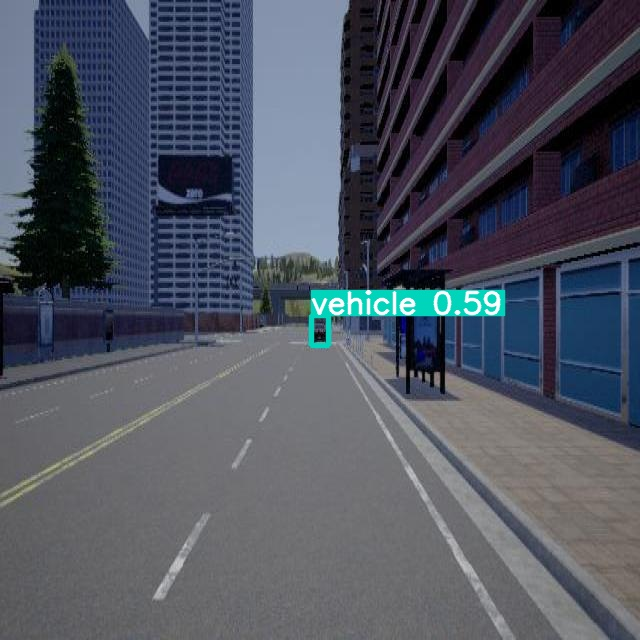

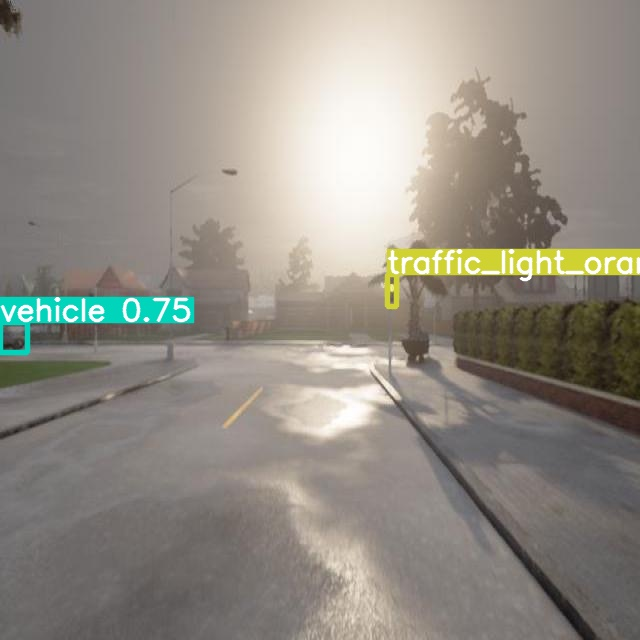

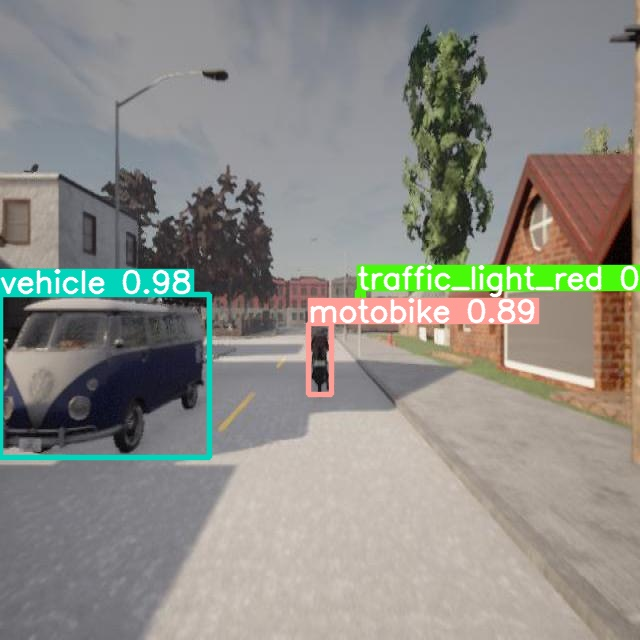

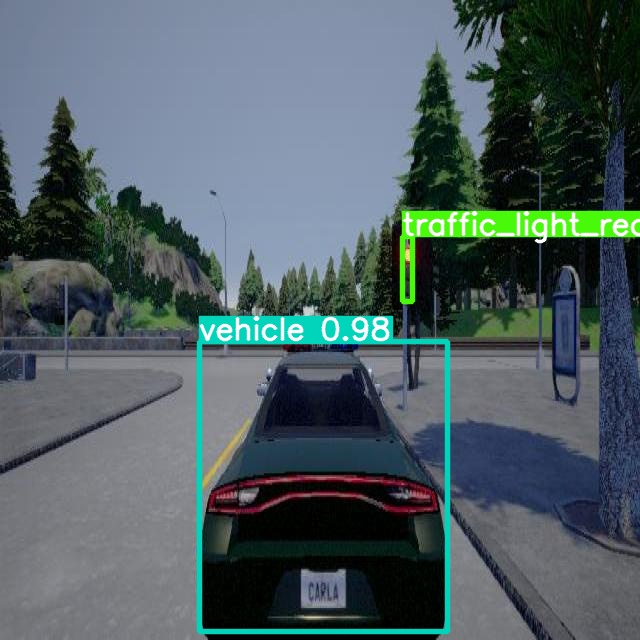

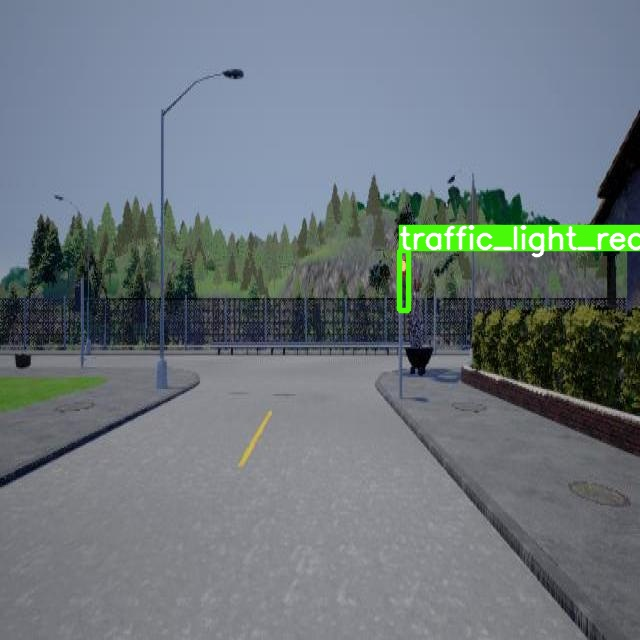

...

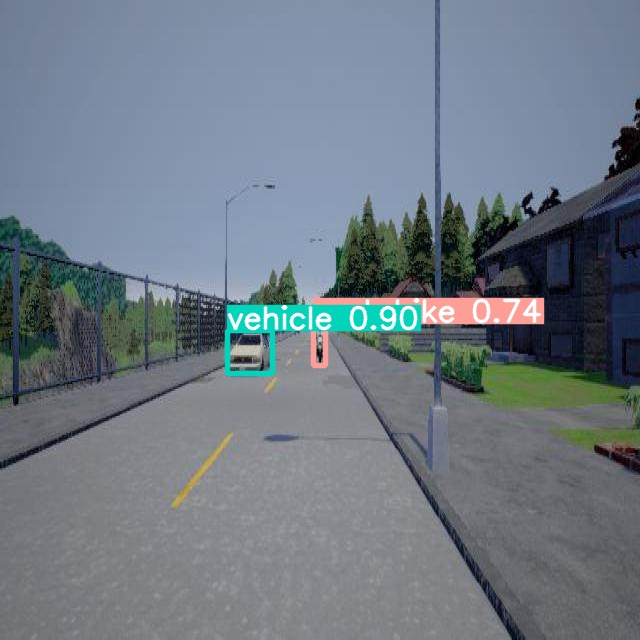

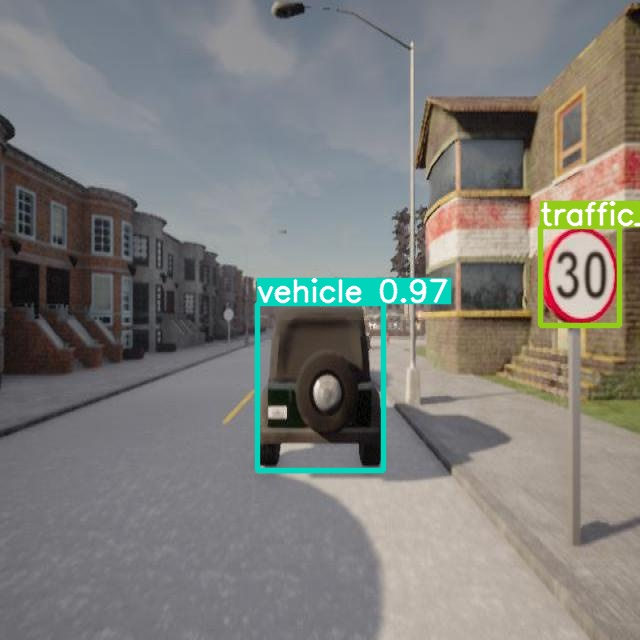

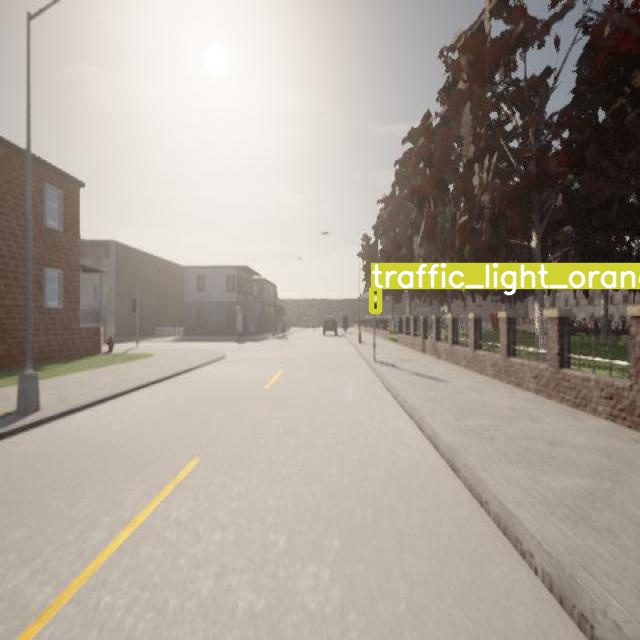

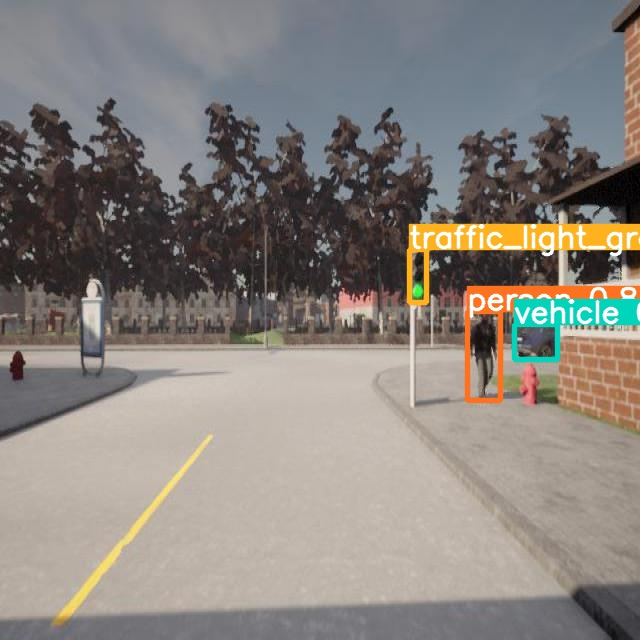

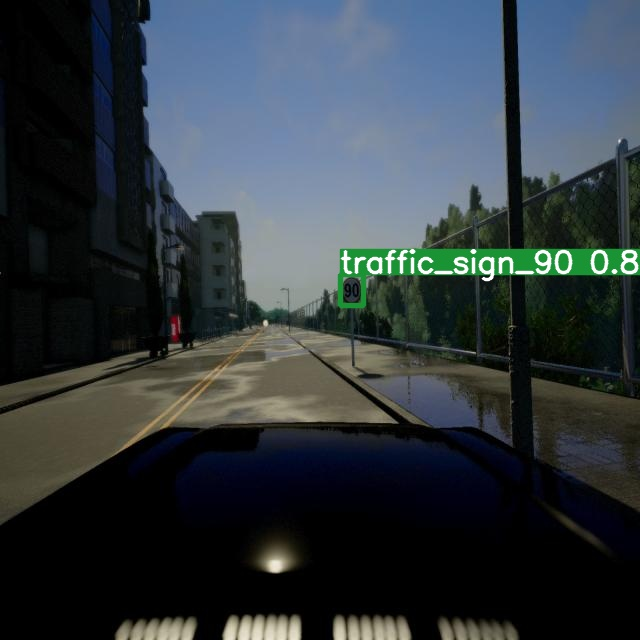

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'):
    display(Image(filename=imageName))
    print("\n")

In [ ]:
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --source ../video4.mp4 --conf 0.4

detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=../video4.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-304-g22361691 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7270791 parameters, 0 gradients
video 1/1 (1/479) /content/video4.mp4: 384x640 (no detections), 53.4ms
video 1/1 (2/479) /content/video4.mp4: 384x640 (no detections), 8.3ms
video 1/1 (3/479) /content/video4.mp4: 384x640 (no detections), 8.1ms
video 1/1 (4/479) /content/video4.mp4: 384x640 (no detections), 8.1ms
video 1/1 (5/479) /content/video4.mp4: 384x640 